In [0]:
#read dataset
df1 = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/tables/Electric_Vehicle_Population_Data-2.csv")

In [0]:
#display the dataframe
display(df1)

VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
5YJYGDEE1L,King,Seattle,WA,98122,2020,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,291,0,37,125701579,POINT (-122.30839 47.610365),CITY OF SEATTLE - (WA)|CITY OF TACOMA - (WA),53033007800
7SAYGDEE9P,Snohomish,Bothell,WA,98021,2023,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not been researched,0,0,1,244285107,POINT (-122.179458 47.802589),PUGET SOUND ENERGY INC,53061051938
5YJSA1E4XK,King,Seattle,WA,98109,2019,TESLA,MODEL S,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,270,0,36,156773144,POINT (-122.34848 47.632405),CITY OF SEATTLE - (WA)|CITY OF TACOMA - (WA),53033006800
5YJSA1E27G,King,Issaquah,WA,98027,2016,TESLA,MODEL S,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,210,0,5,165103011,POINT (-122.03646 47.534065),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),53033032104
5YJYGDEE5M,Kitsap,Suquamish,WA,98392,2021,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not been researched,0,0,23,205138552,POINT (-122.55717 47.733415),PUGET SOUND ENERGY INC,53035940100
3FA6P0SU8H,Thurston,Yelm,WA,98597,2017,FORD,FUSION,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,21,0,2,122057736,POINT (-122.61023 46.94126),PUGET SOUND ENERGY INC,53067012532
1N4AZ0CP2D,Yakima,Yakima,WA,98903,2013,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,75,0,14,150126840,POINT (-120.477805 46.553505),PACIFICORP,53077003003
KNAGV4LD9J,Snohomish,Bothell,WA,98012,2018,KIA,OPTIMA,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,29,0,1,290605598,POINT (-122.1873 47.820245),PUGET SOUND ENERGY INC,53061052107
1N4AZ0CP8F,Kitsap,Port Orchard,WA,98366,2015,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,84,0,26,137322111,POINT (-122.639265 47.5373),PUGET SOUND ENERGY INC,53035092400
5UXTA6C03N,King,Auburn,WA,98001,2022,BMW,X5,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,30,0,47,240226332,POINT (-122.2849393 47.3384055),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),53033029902


In [0]:
#display summary for the dataframe.
display(df1.summary())

summary,VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
count,177866,177861,177861,177866,177861,177866,177866,177866,177866,177866,177866,177866,177477,177866,177857,177861,177861
mean,null,null,null,null,98172.45350582758,2020.51551167733,null,500.5324840764331,null,null,58.842162077069254,1073.1093632284978,29.12748130743702,2.2023126605454668E8,null,null,5.297672105555797E10
stddev,null,null,null,null,2442.4506680215495,2.98938395019198,null,14.919059754188417,null,null,91.98129769418432,8358.624956091091,14.89216853945376,7.58498661225649E7,null,null,1.5780467711669004E9
min,1C4JJXN60P,Ada,Aberdeen,AE,01545,1997,ALFA ROMEO,330E,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,0,0,1,100005,POINT (-104.50359 37.16543),AVISTA CORP,01001020100
25%,null,null,null,null,98052.0,2019.0,null,500.0,null,null,0.0,0.0,18.0,1.81460912E8,null,null,5.3033009702E10
50%,null,null,null,null,98122.0,2022.0,null,500.0,null,null,0.0,0.0,33.0,2.28247022E8,null,null,5.3033029602E10
75%,null,null,null,null,98370.0,2023.0,null,500.0,null,null,75.0,0.0,42.0,2.54840848E8,null,null,5.3053073001E10
max,ZASPATDWXR,Yuba,Zillah,WY,99577,2024,WHEEGO ELECTRIC CARS,XM,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,97,98950,9,9996612,POINT (-98.66992 29.5366501),PUGET SOUND ENERGY INC||PUD NO 1 OF WHATCOM COUNTY,56033000100


In [0]:
from pyspark.sql.functions import when, count, col,mean

#count number of null values in each column of DataFrame
df1.select([count(when(col(c).isNull(), c)).alias(c) for c in df1.columns]).show()

+----------+------+----+-----+-----------+----------+----+-----+---------------------+-------------------------------------------------+--------------+---------+--------------------+--------------+----------------+----------------+-----------------+
|VIN (1-10)|County|City|State|Postal Code|Model Year|Make|Model|Electric Vehicle Type|Clean Alternative Fuel Vehicle (CAFV) Eligibility|Electric Range|Base MSRP|Legislative District|DOL Vehicle ID|Vehicle Location|Electric Utility|2020 Census Tract|
+----------+------+----+-----+-----------+----------+----+-----+---------------------+-------------------------------------------------+--------------+---------+--------------------+--------------+----------------+----------------+-----------------+
|         0|     5|   5|    0|          5|         0|   0|    0|                    0|                                                0|             0|        0|                 389|             0|               9|               5|                5|


In [0]:
# Calculate mode of the categorical column
mode_value = df1.groupBy("County").count().orderBy(col("count").desc()).select("County").limit(1).collect()[0][0]

# Replace null values with mode
imputed_df = df1.withColumn("County", when(col("County").isNull(), mode_value).otherwise(col("County")))
mode_value = df1.groupBy("City").count().orderBy(col("count").desc()).select("City").limit(1).collect()[0][0]
imputed_df = imputed_df.withColumn("City", when(col("City").isNull(), mode_value).otherwise(col("City")))
mode_value = df1.groupBy("Postal Code").count().orderBy(col("count").desc()).select("Postal Code").limit(1).collect()[0][0]
imputed_df = imputed_df.withColumn("Postal Code", when(col("Postal Code").isNull(), mode_value).otherwise(col("Postal Code")))
mode_value = df1.groupBy("Legislative District").count().orderBy(col("count").desc()).select("Legislative District").limit(1).collect()[0][0]
imputed_df = imputed_df.withColumn("Legislative District", when(col("Legislative District").isNull(), mode_value).otherwise(col("Legislative District")))


# Calculate mean of the numeric column
mean_value = df1.agg(mean(col("Electric Range"))).collect()[0][0]

# Replace null values with mean
imputed_df = imputed_df.withColumn("Electric Range", when(col("Electric Range").isNull(), mean_value).otherwise(col("Electric Range")))


# Show the DataFrame with imputed values
display(imputed_df)

VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
5YJYGDEE1L,King,Seattle,WA,98122,2020,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,291,0,37,125701579,POINT (-122.30839 47.610365),CITY OF SEATTLE - (WA)|CITY OF TACOMA - (WA),53033007800
7SAYGDEE9P,Snohomish,Bothell,WA,98021,2023,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not been researched,0,0,1,244285107,POINT (-122.179458 47.802589),PUGET SOUND ENERGY INC,53061051938
5YJSA1E4XK,King,Seattle,WA,98109,2019,TESLA,MODEL S,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,270,0,36,156773144,POINT (-122.34848 47.632405),CITY OF SEATTLE - (WA)|CITY OF TACOMA - (WA),53033006800
5YJSA1E27G,King,Issaquah,WA,98027,2016,TESLA,MODEL S,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,210,0,5,165103011,POINT (-122.03646 47.534065),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),53033032104
5YJYGDEE5M,Kitsap,Suquamish,WA,98392,2021,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not been researched,0,0,23,205138552,POINT (-122.55717 47.733415),PUGET SOUND ENERGY INC,53035940100
3FA6P0SU8H,Thurston,Yelm,WA,98597,2017,FORD,FUSION,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,21,0,2,122057736,POINT (-122.61023 46.94126),PUGET SOUND ENERGY INC,53067012532
1N4AZ0CP2D,Yakima,Yakima,WA,98903,2013,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,75,0,14,150126840,POINT (-120.477805 46.553505),PACIFICORP,53077003003
KNAGV4LD9J,Snohomish,Bothell,WA,98012,2018,KIA,OPTIMA,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,29,0,1,290605598,POINT (-122.1873 47.820245),PUGET SOUND ENERGY INC,53061052107
1N4AZ0CP8F,Kitsap,Port Orchard,WA,98366,2015,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,84,0,26,137322111,POINT (-122.639265 47.5373),PUGET SOUND ENERGY INC,53035092400
5UXTA6C03N,King,Auburn,WA,98001,2022,BMW,X5,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,30,0,47,240226332,POINT (-122.2849393 47.3384055),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),53033029902


In [0]:
#count number of null values in each column of DataFrame
imputed_df.select([count(when(col(c).isNull(), c)).alias(c) for c in imputed_df.columns]).show()

+----------+------+----+-----+-----------+----------+----+-----+---------------------+-------------------------------------------------+--------------+---------+--------------------+--------------+----------------+----------------+-----------------+
|VIN (1-10)|County|City|State|Postal Code|Model Year|Make|Model|Electric Vehicle Type|Clean Alternative Fuel Vehicle (CAFV) Eligibility|Electric Range|Base MSRP|Legislative District|DOL Vehicle ID|Vehicle Location|Electric Utility|2020 Census Tract|
+----------+------+----+-----+-----------+----------+----+-----+---------------------+-------------------------------------------------+--------------+---------+--------------------+--------------+----------------+----------------+-----------------+
|         0|     0|   0|    0|          0|         0|   0|    0|                    0|                                                0|             0|        0|                   0|             0|               9|               5|                5|


In [0]:
# Count distinct values in the Vehicle Location column
len(imputed_df.select('Vehicle Location').distinct().collect())

Out[10]: 862

In [0]:
# Filter  rows where 'Vehicle Location' or 'Base MSRP' is null

imputed_df = imputed_df.filter(imputed_df['Vehicle Location'].isNotNull())
imputed_df = imputed_df.filter(imputed_df['Base MSRP'].isNotNull())

In [0]:
#check for null values in all columns after filtering

imputed_df.select([count(when(col(c).isNull(), c)).alias(c) for c in imputed_df.columns]).show()

+----------+------+----+-----+-----------+----------+----+-----+---------------------+-------------------------------------------------+--------------+---------+--------------------+--------------+----------------+----------------+-----------------+
|VIN (1-10)|County|City|State|Postal Code|Model Year|Make|Model|Electric Vehicle Type|Clean Alternative Fuel Vehicle (CAFV) Eligibility|Electric Range|Base MSRP|Legislative District|DOL Vehicle ID|Vehicle Location|Electric Utility|2020 Census Tract|
+----------+------+----+-----+-----------+----------+----+-----+---------------------+-------------------------------------------------+--------------+---------+--------------------+--------------+----------------+----------------+-----------------+
|         0|     0|   0|    0|          0|         0|   0|    0|                    0|                                                0|             0|        0|                   0|             0|               0|               0|                0|


In [0]:
# imputed_df.(df.State < 40).count()
df_without_WA = imputed_df.filter(imputed_df.State != 'WA')
display(df_without_WA.groupBy('State').count())

State,count
NV,8
DC,3
VA,46
KY,3
CA,101
NC,16
MD,31
IL,15
PA,4
AZ,10


Databricks visualization. Run in Databricks to view.

In [0]:
#filter the dataFrame to include  records from the WA state.

df_with_WA = imputed_df.filter(imputed_df.State == 'WA')
display(df_with_WA)

VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
5YJYGDEE1L,King,Seattle,WA,98122,2020,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,291,0,37,125701579,POINT (-122.30839 47.610365),CITY OF SEATTLE - (WA)|CITY OF TACOMA - (WA),53033007800
7SAYGDEE9P,Snohomish,Bothell,WA,98021,2023,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not been researched,0,0,1,244285107,POINT (-122.179458 47.802589),PUGET SOUND ENERGY INC,53061051938
5YJSA1E4XK,King,Seattle,WA,98109,2019,TESLA,MODEL S,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,270,0,36,156773144,POINT (-122.34848 47.632405),CITY OF SEATTLE - (WA)|CITY OF TACOMA - (WA),53033006800
5YJSA1E27G,King,Issaquah,WA,98027,2016,TESLA,MODEL S,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,210,0,5,165103011,POINT (-122.03646 47.534065),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),53033032104
5YJYGDEE5M,Kitsap,Suquamish,WA,98392,2021,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not been researched,0,0,23,205138552,POINT (-122.55717 47.733415),PUGET SOUND ENERGY INC,53035940100
3FA6P0SU8H,Thurston,Yelm,WA,98597,2017,FORD,FUSION,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,21,0,2,122057736,POINT (-122.61023 46.94126),PUGET SOUND ENERGY INC,53067012532
1N4AZ0CP2D,Yakima,Yakima,WA,98903,2013,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,75,0,14,150126840,POINT (-120.477805 46.553505),PACIFICORP,53077003003
KNAGV4LD9J,Snohomish,Bothell,WA,98012,2018,KIA,OPTIMA,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,29,0,1,290605598,POINT (-122.1873 47.820245),PUGET SOUND ENERGY INC,53061052107
1N4AZ0CP8F,Kitsap,Port Orchard,WA,98366,2015,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,84,0,26,137322111,POINT (-122.639265 47.5373),PUGET SOUND ENERGY INC,53035092400
5UXTA6C03N,King,Auburn,WA,98001,2022,BMW,X5,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,30,0,47,240226332,POINT (-122.2849393 47.3384055),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),53033029902


In [0]:
#count the number of records for each city.

display(df_with_WA.groupBy('City').count())

City,count
Bingen,7
Edmonds,1896
Tumwater,639
Auburn,1897
Sultan,173
Monroe,765
Woodland,175
Bainbridge Island,1760
Bothell,5863
Kenmore,1028


In [0]:
from pyspark.sql import functions as F

#group by city and count the number of records for each city and filter cities which have mor ethan 900 records.
df_WA_city_count = df_with_WA.groupBy('City').count()
df_WA_city_count_more900 = df_WA_city_count.filter(F.col('count') > 900)
display(df_WA_city_count_more900.orderBy('count'))


City,count
Newcastle,906
Richland,923
Lacey,943
Ridgefield,946
Bonney Lake,992
Kenmore,1028
Port Orchard,1069
Marysville,1207
Bremerton,1299
Puyallup,1315


Databricks visualization. Run in Databricks to view.

In [0]:
brand_w_count = imputed_df.groupBy('Make').count()
brand_with_more_customers = brand_w_count.filter(F.col('count') > 5000)
brand_with_less_customers = brand_w_count.filter((F.col('count') < 5000) & (F.col('count') > 1000))

In [0]:
display(brand_with_more_customers)

Make,count
TOYOTA,6287
NISSAN,13997
FORD,9199
CHEVROLET,13677
TESLA,79655
BMW,7570
VOLKSWAGEN,5004
KIA,7432


Databricks visualization. Run in Databricks to view.

In [0]:
display(brand_with_less_customers)

Make,count
PORSCHE,1139
HYUNDAI,4405
AUDI,3646
JEEP,4479
VOLVO,4133
RIVIAN,4312
MERCEDES-BENZ,1589
CHRYSLER,2993


Databricks visualization. Run in Databricks to view.

In [0]:
df_brand_range = imputed_df.groupBy('Make').agg({'Electric Range': 'mean'})
df_brand_range = df_brand_range.filter(F.col('avg(Electric Range)') > 20)
display(df_brand_range)

Make,avg(Electric Range)
PORSCHE,44.81211589113257
FIAT,85.6454081632653
TOYOTA,28.095594083028473
NISSAN,80.3492176895049
AUDI,50.98464070213933
ALFA ROMEO,33.0
DODGE,32.0
CHEVROLET,94.55969876434891
JAGUAR,203.74137931034483
JEEP,22.365706630944405


Databricks visualization. Run in Databricks to view.

In [0]:
year_count = imputed_df.groupBy('Model Year').count()
year_count = year_count.filter(F.col('count')>1000)
display(year_count)

Model Year,count
2016,5483
2020,11768
2012,1618
2019,10939
2017,8559
2014,3509
2013,4408
2018,14322
2022,27775
2023,57586


Databricks visualization. Run in Databricks to view.

In [0]:
#list numeric columns and select it from dataframe
numeric_column = ['Electric Range','Base MSRP','Legislative District']
numeric_column_df = df_with_WA.select(numeric_column)  
display(numeric_column_df)

Electric Range,Base MSRP,Legislative District
291,0,37
0,0,1
270,0,36
210,0,5
0,0,23
21,0,2
75,0,14
29,0,1
84,0,26
30,0,47


In [0]:
#Convert numeric column to int.
for column in numeric_column:
    df_with_WA = df_with_WA.withColumn(column, col(column).cast('int'))

#Split dataframe into test and train data
trainDF, testDF = df_with_WA.randomSplit([0.8, 0.2], seed=42)

print(trainDF.cache().count()) 
print(testDF.count()) 

142198
35275


/databricks/python/lib/python3.9/site-packages/seaborn/matrix.py:305: UserWarning: Attempting to set identical left == right == 0 results in singular transformations; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))
/databricks/python/lib/python3.9/site-packages/seaborn/matrix.py:305: UserWarning: Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))


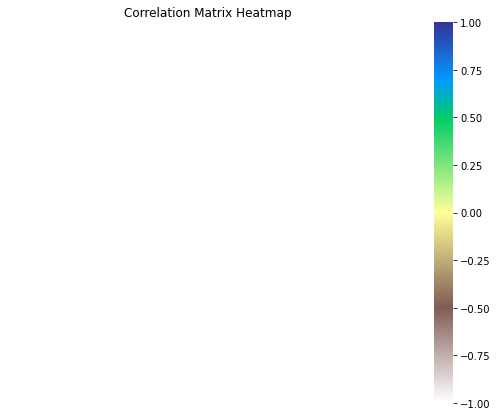

In [0]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Convert  DataFrame to Pandas 
numeric_pd_df = numeric_column_df.toPandas()

# corr matrix
correlation_matrix = numeric_pd_df.corr()

# heatmap
plt.figure(figsize=(9, 7))
sns.heatmap(correlation_matrix, annot=True, cmap='terrain_r', vmin=-1, vmax=1)
plt.title('Correlation Matrix Heatmap')
plt.show()

In [0]:
from pyspark.ml.feature import StringIndexer, OneHotEncoder
from pyspark.ml.classification import RandomForestClassifier
from pyspark.ml.feature import VectorAssembler

# Define categorical column
categoricalCols = [ 'County', 'City', 'State', 'Make', 'Model', 'Electric Vehicle Type', 'Vehicle Location', 'Electric Utility']
categoricalCols.remove('State')
# Initialize StringIndexer for categorical features
stringIndexer = StringIndexer(inputCols=categoricalCols, outputCols=[x + "Index" for x in categoricalCols],handleInvalid="keep")

# Initialize OneHotEncoder for the output of StringIndexer
encoder = OneHotEncoder(inputCols=stringIndexer.getOutputCols(), outputCols=[x + "OHE" for x in categoricalCols])

# Initialize StringIndexer for the label/target column
labelToIndex = StringIndexer(inputCol="Clean Alternative Fuel Vehicle (CAFV) Eligibility", outputCol="label")

# Combine all feature columns into a single feature vector
assemblerInputs = [c + "OHE" for c in categoricalCols] + numeric_column  # Note: using OHE columns
vecAssembler = VectorAssembler(inputCols=assemblerInputs, outputCol="features")

In [0]:
from pyspark.ml import Pipeline
# Define the pipeline based on the stages created in previous steps.
pipeline = Pipeline(stages=[stringIndexer,encoder,vecAssembler,labelToIndex])

# Define the pipeline model.
pipelineModel = pipeline.fit(trainDF) 
predDF = pipelineModel.transform(trainDF) 
predDF1 = pipelineModel.transform(testDF) 
# Define RandomForestClassifier
from pyspark.ml.classification import RandomForestClassifier
# Initialize the RandomForestClassifier
rfClassifier = RandomForestClassifier(featuresCol="features", labelCol="label", numTrees=10)

# Train the model on the transformed DataFrame
rfModel = rfClassifier.fit(predDF)

# Make predictions on the training data (you can also use a separate test set)
predictions = rfModel.transform(predDF1)

In [0]:
predictions.select("features", "label", "prediction", "probability").show()

+--------------------+-----+----------+--------------------+
|            features|label|prediction|         probability|
+--------------------+-----+----------+--------------------+
|(1287,[0,51,506,5...|  2.0|       2.0|[0.23765410458530...|
|(1287,[0,49,506,5...|  2.0|       2.0|[0.23765410458530...|
|(1287,[0,49,506,5...|  2.0|       2.0|[0.23765410458530...|
|(1287,[0,44,506,5...|  2.0|       2.0|[0.23765410458530...|
|(1287,[0,49,506,5...|  2.0|       2.0|[0.23765410458530...|
|(1287,[0,49,506,5...|  2.0|       2.0|[0.23765410458530...|
|(1287,[0,49,506,5...|  2.0|       2.0|[0.23765410458530...|
|(1287,[0,40,506,5...|  2.0|       2.0|[0.23765410458530...|
|(1287,[0,49,506,5...|  2.0|       2.0|[0.23765410458530...|
|(1287,[0,49,506,5...|  2.0|       2.0|[0.23765410458530...|
|(1287,[0,49,506,5...|  2.0|       2.0|[0.23765410458530...|
|(1287,[16,177,506...|  2.0|       2.0|[0.23765410458530...|
|(1287,[0,49,506,5...|  2.0|       2.0|[0.23765410458530...|
|(1287,[0,45,506,5...|  

In [0]:
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

# Calculate the accuracy of the predictions

evaluator = MulticlassClassificationEvaluator(labelCol="label", predictionCol="prediction", metricName="accuracy")
accuracy = evaluator.evaluate(predictions)

print("Accuracy:", accuracy)

Accuracy: 0.7677958894401133


In [0]:
#Extract the feature columns from the DataFrame and retrieve  feature importances.

feature_columns = predDF.columns[:-1] 
feature_importances = rfModel.featureImportances

# Create a dictionary of feature importances
importances_dict = {feature_columns[i]: feature_importances[i] for i in range(len(feature_columns))}

# Print feature importances
for feature, importance in importances_dict.items():
    print(f"Feature: {feature}, Importance: {importance}")

Feature: VIN (1-10), Importance: 0.0
Feature: County, Importance: 0.000643107354261138
Feature: City, Importance: 0.0
Feature: State, Importance: 0.0001008112561105265
Feature: Postal Code, Importance: 0.0
Feature: Model Year, Importance: 0.0
Feature: Make, Importance: 0.0
Feature: Model, Importance: 0.00022142678343424143
Feature: Electric Vehicle Type, Importance: 0.0
Feature: Clean Alternative Fuel Vehicle (CAFV) Eligibility, Importance: 0.0
Feature: Electric Range, Importance: 0.0
Feature: Base MSRP, Importance: 0.0
Feature: Legislative District, Importance: 0.0
Feature: DOL Vehicle ID, Importance: 0.0
Feature: Vehicle Location, Importance: 0.0
Feature: Electric Utility, Importance: 0.0
Feature: 2020 Census Tract, Importance: 0.0
Feature: CountyIndex, Importance: 0.0
Feature: CityIndex, Importance: 0.0
Feature: MakeIndex, Importance: 0.0
Feature: ModelIndex, Importance: 0.0
Feature: Electric Vehicle TypeIndex, Importance: 0.0
Feature: Vehicle LocationIndex, Importance: 0.0
Feature:

In [0]:
#reserach question 2(Which city consistently has electric cars that can drive the farthest on a single charge, considering the brand and type of electric vehicle, over time)
from pyspark.sql.functions import col, min,max ,avg
from pyspark.sql.functions import desc, asc

# Average of electric range of each car model in each city.
city_avg_range = df_with_WA.groupBy("City", "Model Year", "Make", "Model","State").agg(avg("Electric Range").alias("Avg Car Electric Range In City")).orderBy(desc("Avg Car Electric Range In City"))

#Average of each car model.
car_avg_range = df_with_WA.groupBy("Model Year", "Make", "Model").agg(avg("Electric Range").alias("Avg Car Electric Range")).orderBy(desc("Avg Car Electric Range"))

# Perform an inner join between the DataFrames city_avg_range and car_avg_range.

inner_join_df = city_avg_range.join(car_avg_range, ["Model Year", "Make", "Model"], "inner")
display(inner_join_df.orderBy(desc("Avg Car Electric Range In City")))

Model Year,Make,Model,City,State,Avg Car Electric Range In City,Avg Car Electric Range
2020,TESLA,MODEL S,Chattaroy,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Tahuya,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Quincy,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Carnation,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Woodland,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Battle Ground,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Tukwila,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Black Diamond,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Snoqualmie,WA,334.6666666666667,331.3071253071253
2020,TESLA,MODEL S,Lake Stevens,WA,334.2,331.3071253071253


In [0]:
# Filter DataFrame to include only records where the average electric range in the city is greater than the overall average electric range

filter_range = inner_join_df.filter(inner_join_df["Avg Car Electric Range In City"] > inner_join_df["Avg Car Electric Range"])
display(filter_range.orderBy(desc("Avg Car Electric Range In City")))

Model Year,Make,Model,City,State,Avg Car Electric Range In City,Avg Car Electric Range
2020,TESLA,MODEL S,Chattaroy,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Tahuya,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Quincy,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Carnation,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Woodland,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Battle Ground,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Tukwila,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Black Diamond,WA,337.0,331.3071253071253
2020,TESLA,MODEL S,Snoqualmie,WA,334.6666666666667,331.3071253071253
2020,TESLA,MODEL S,Lake Stevens,WA,334.2,331.3071253071253


In [0]:
#Count of car models in each city which has avg greater than the avg of the electric range in WA.
count_city_avg_range = filter_range.groupBy("City").count()

# Assuming df_WA_city_count is already created as shown previously
# Sort by the 'count' column in descending order
count_city_avg_range_count_sorted = count_city_avg_range.orderBy(F.col("count").desc())

count_city_avg_range_count_filtered = count_city_avg_range_count_sorted.filter(F.col('count') > 15)
# To display the sorted DataFrame
display(count_city_avg_range_count_filtered)


#The top 5 cities, including Seattle, Bothell, Bellevue, Bainbridge Island, and Woodinville, have the most car models with an average electric range higher than the overall average electric range in Washington (WA).

City,count
Seattle,27
Bothell,24
Bainbridge Island,23
Bellevue,23
Woodinville,22
Kirkland,21
Redmond,21
Vancouver,20
Camas,19
Sammamish,18


Databricks visualization. Run in Databricks to view.